# Clustering Collisions

__Last update: June 2022__

This notebook analyses the datasets pulled in the `dft-collision-data.ipynb` notebook. The method explored in this notebook clusters collisions to create proxies for junctions and then tries to rank these to identify the most dangerous.

The initial aim is to recreate the junctions that have already been identified by LCC as 'dangerous' to see whether we can do this automatically from data:

Current dangerous junctions map - https://lcc.org.uk/campaigns/dangerous-junctions/

__IDEAs:__
- What happens if two cyclists seriously injured at junction, does that count twice?
- Can we add a recency bias to the junction weighting

In [4]:
import os
import geopandas
import numpy as np
import pandas as pd
import networkx as nx
import contextily as cx
import seaborn as sns
import matplotlib.pyplot as plt

from scipy import spatial
from dotenv import load_dotenv
from ipyleaflet import Map, MarkerCluster, basemaps, Marker
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN, AgglomerativeClustering

load_dotenv()
os_api_key = os.getenv('OS_API_KEY')

%config InlineBackend.figure_format = 'retina'

sns.set_palette('Dark2')
plt.rcParams["font.family"] = "Calibri"
plt.rcParams["font.size"] = 12

In [50]:
def weight_accident_severity(row):
    '''
    Upweights more severe collisions for junction comparison.
    '''
    year = row['accident_year']
    severity = row['max_cyclist_severity']
    
#     recency_weight = (year - 2000) / 20
    recency_weight = np.log10(year - 1999)
#     recency_weight = 1
    
    if severity == 'Fatal':
        return 3 * recency_weight
    if severity == 'Serious':
        return 1 * recency_weight
    else:
        return 0
    
    
def is_serious(severity):
    '''
    Tag serious collisions
    '''
    if severity == 'Serious':
        return 1
    else:
        return 0
    
    
def is_fatal(severity):
    '''
    Tag fatal collisions
    '''
    if severity == 'Fatal':
        return 1
    else:
        return 0
    
    
def get_nearest_junction(row, tree):
    coordinate = row[['latitude', 'longitude']].values
    result = tree.query(coordinate)

    distance = result[0]
    junction_id = result[1]
    return distance, junction_id

# 1. Read in data

View sample of random collision for reference.

In [51]:
# not a massive fan of the use of the term 'accidents'
collisions = pd.read_csv('../data/london-crashes.csv')

collisions.rename(columns={'accident_index': 'id'}, inplace=True)

# example row
collisions.sample(1).T

,4404
id,200201EO01898
accident_year,2002
accident_reference,01EO01898
location_easting_osgr,530070.0
location_northing_osgr,182800.0
longitude,-0.126293
latitude,51.529084
police_force,Metropolitan Police
accident_severity,Slight
number_of_vehicles,2


# 1. Filter and split data

Remove 'Private drive or entrance' junction types for now and split out data into two dataframes:
1. `slight` - slight collisions'
2. `serious_or_slight` - serious or fatal

__Note:__ important to use the calculated `max_cyclist_severity` field for this.

In [52]:
print(collisions.accident_severity.unique())
print(collisions.junction_detail.unique())

['Slight' 'Serious' 'Fatal']
['T or staggered junction' 'Crossroads' 'Other junction'
 'More than 4 arms (not roundabout)' 'Private drive or entrance'
 'Roundabout' 'Slip road' 'Mini-roundabout']


In [53]:
junction_collisions = collisions[
    # (collisions['accident_severity'] != 'Slight') &
    (collisions['junction_detail'] != 'Private drive or entrance')
]

slight = junction_collisions[junction_collisions['max_cyclist_severity'] == 'Slight'].copy()
serious_or_fatal = junction_collisions[junction_collisions['max_cyclist_severity'] != 'Slight'].copy()

serious_or_fatal['collision_metric'] = serious_or_fatal.apply(weight_accident_severity, axis=1)

junction_collisions.head()

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,datetime,max_cyclist_severity
0,200001BS00005,2000,01BS00005,526300.0,178910.0,-0.182005,51.494979,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002835,2000-01-02T14:00:00Z,Slight
1,200001BS00010,2000,01BS00010,525660.0,179660.0,-0.190953,51.501862,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002826,2000-01-06T19:43:00Z,Slight
2,200001BS00019,2000,01BS00019,523970.0,179950.0,-0.215187,51.504841,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002869,2000-01-11T15:30:00Z,Slight
3,200001BS00024,2000,01BS00024,527100.0,178000.0,-0.170814,51.486622,Metropolitan Police,Serious,2,...,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002844,2000-01-13T08:00:00Z,Serious
4,200001BS00036,2000,01BS00036,527940.0,178900.0,-0.158397,51.494521,Metropolitan Police,Serious,2,...,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002859,2000-01-19T05:50:00Z,Serious


# 3. Plot all collisions

Will add map later. With this many collisions it's difficult to read with a map overlay, plus it's possible to make out the roads anyways.

Can already see it will probably difficult finding a clustering algorithm that works on the differing regions of density, since central London is much more dense in points, but we still want junction clusters to be found outside of central London.

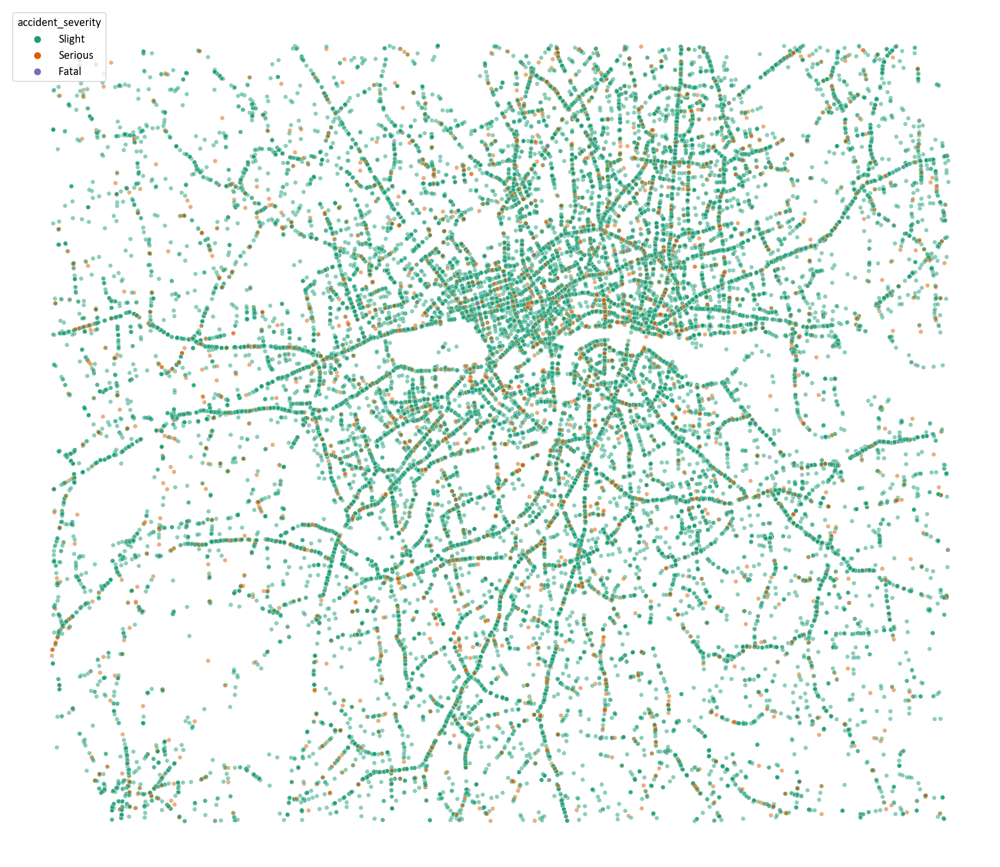

In [54]:
fig, ax = plt.subplots(figsize=(18, 16))
sns.scatterplot(
    data=junction_collisions,
    x='longitude',
    y='latitude',
    hue='accident_severity',
    alpha=.5,
    s=20
);

ax.set_axis_off()

# 4. Convert to Geo Pandas DF

This will allow us to plot maps underneath data etc.

## 4.1 Plot all collisions

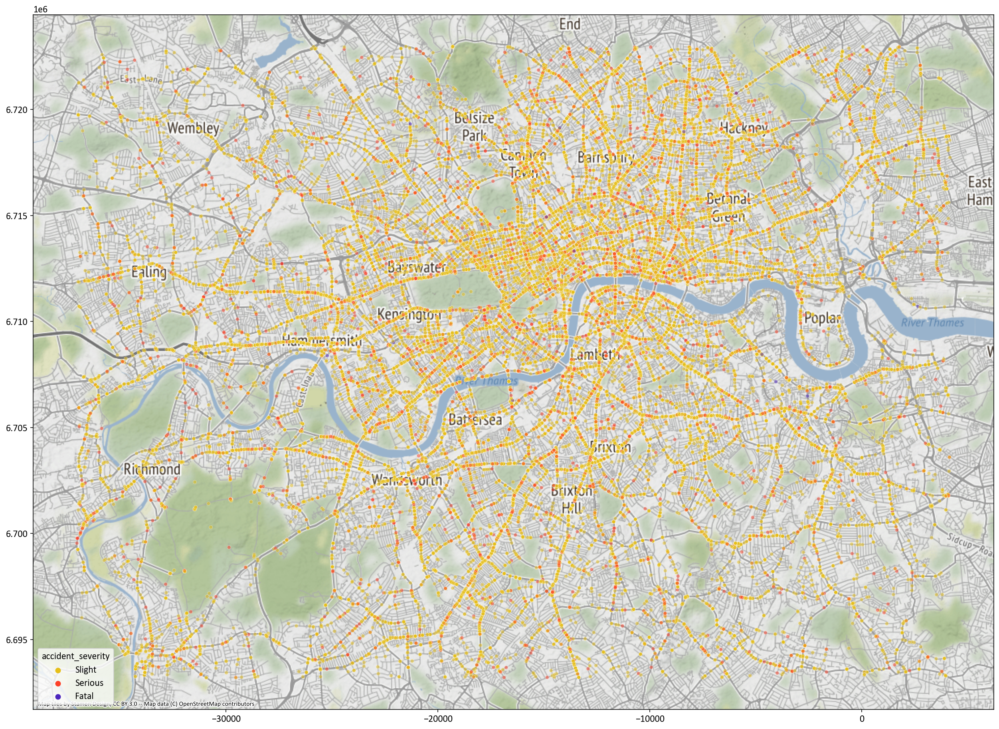

In [55]:
gpd_junction_collisions = geopandas.GeoDataFrame(
    junction_collisions,
    geometry=geopandas.points_from_xy(junction_collisions.longitude, junction_collisions.latitude, crs="EPSG:4326")
)

gpd_junction_collisions.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junction_collisions.geometry.x,
    y=gpd_junction_collisions.geometry.y,
    hue=gpd_junction_collisions.accident_severity,
    alpha=.5,
    s=20,
    palette=sns.color_palette('CMRmap_r', 3)
);

cx.add_basemap(ax)

## 4.2 Plot just serious or fatal collisions

Not the easiest to read!

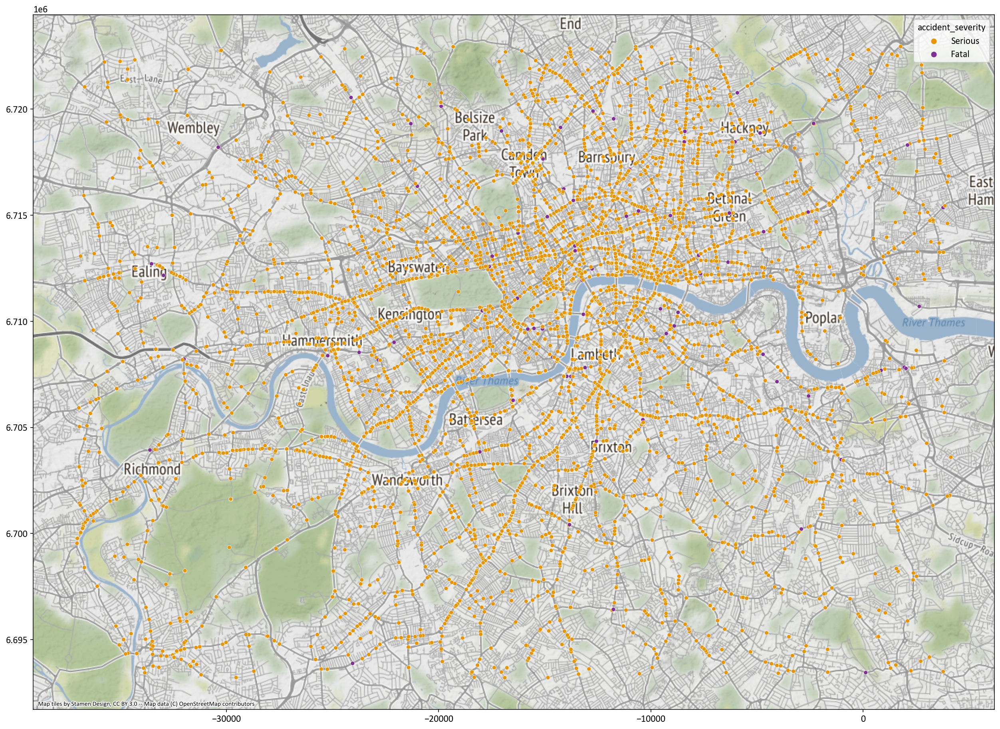

In [56]:
fig, ax = plt.subplots(figsize=(24, 16))

plt_data = gpd_junction_collisions[
    gpd_junction_collisions.accident_severity != 'Slight'
]

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.accident_severity,
    alpha=1,
    s=25,
    palette=sns.color_palette('CMRmap_r', 2)
);

cx.add_basemap(ax)
del plt_data

# 5. Clustering

Clustering just serious or fatal since there are likely too many points otherwise.

Can we cluster points to identify junctions and then allow us to filter to high collision junctions?

Best params so far:
- `eps=.03`
- `min_samples=3`

In [57]:
scaler = StandardScaler()

X = serious_or_fatal[['longitude', 'latitude']]
X = scaler.fit_transform(X)

clustering = DBSCAN(eps=.03, min_samples=3).fit(X)
# clustering = AgglomerativeClustering(n_clusters=1500).fit(X)

serious_or_fatal['cluster'] = clustering.labels_.astype(str)

print(f'Found {len(set(clustering.labels_)) - 1} clusters (includes 1 outlier cluster)')

serious_or_fatal['n_serious'] = serious_or_fatal['accident_severity'].apply(is_serious)
serious_or_fatal['n_fatal'] = serious_or_fatal['accident_severity'].apply(is_fatal)

junctions = (
    serious_or_fatal[serious_or_fatal['cluster'] != '-1']  # filter out 'outlier' cluster
    .groupby('cluster')
    .agg({
        'latitude': 'mean',
        'longitude': 'mean',
        'collision_metric': 'sum',
        'n_serious': 'sum',
        'n_fatal': 'sum'})
    .reset_index()
    .reset_index()
)

# TODO: see if we can add in sllight collisions so this works.
# junctions['serious_slight_ratio'] = junctions['is_serious_or_fatal'] / junctions['is_slight']

junctions['danger_rank'] = junctions['collision_metric'].rank(ascending=False)
junctions.sort_values(by='danger_rank', inplace=True)

gpd_junctions = geopandas.GeoDataFrame(
    junctions,
    geometry=geopandas.points_from_xy(junctions.longitude, junctions.latitude, crs="EPSG:4326")
)
gpd_junctions.to_crs(epsg=3857, inplace=True)

junctions.head(10)

Found 610 clusters (includes 1 outlier cluster)


,index,cluster,latitude,longitude,collision_metric,n_serious,n_fatal,danger_rank,geometry
224,224,30,51.520412,-0.113629,105.316117,110,8,1.0,POINT (-12649.112 6713870.050)
13,13,11,51.511722,-0.089796,93.127686,97,4,2.0,POINT (-9996.001 6712315.548)
46,46,14,51.514040,-0.104212,86.075965,82,3,3.0,POINT (-11600.827 6712730.223)
556,556,6,51.505712,-0.219658,68.539981,70,0,4.0,POINT (-24452.264 6711240.514)
24,24,12,51.518442,-0.085458,49.671561,48,3,5.0,POINT (-9513.117 6713517.539)
579,579,71,51.493327,-0.100966,46.209946,49,2,6.0,POINT (-11239.508 6709025.914)
346,346,41,51.471540,-0.204010,46.085361,45,0,7.0,POINT (-22710.277 6705131.401)
79,79,17,51.516081,-0.137507,44.394519,43,1,8.0,POINT (-15307.232 6713095.151)
568,568,61,51.482009,-0.112286,42.492280,45,3,9.0,POINT (-12499.593 6707002.549)
59,59,151,51.463710,-0.132432,37.755652,35,0,10.0,POINT (-14742.266 6703732.235)


## 5.1 - Plot Clusters

See if the generated cluster look sensible. Ideally don't want too many overlapping or very close together.

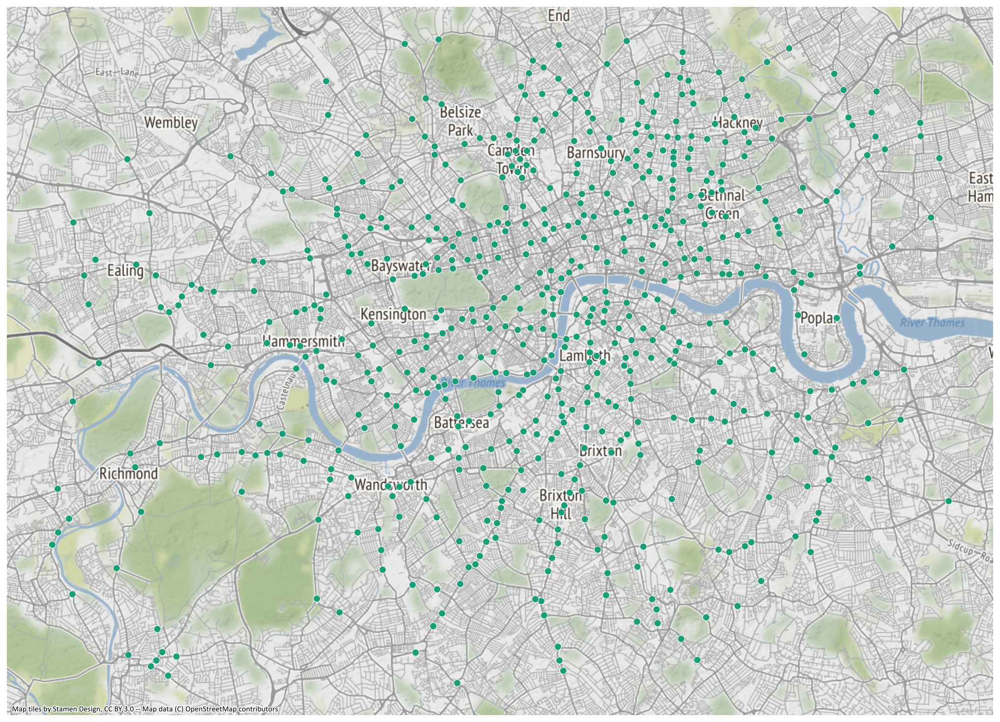

In [58]:
fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions[gpd_junctions['cluster'] != '-1']

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    s=50,
    legend=False
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

## 5.1 - Plot most severe clusters

Ranked by collision metric, where:
- Fatal - counts as a 3
- Serious - counts as a 1

Plot 'top n'. `n=80` for now.

At least by eye this looks pretty good. Most of the already manually identified junctions are here, plus a bunch more...

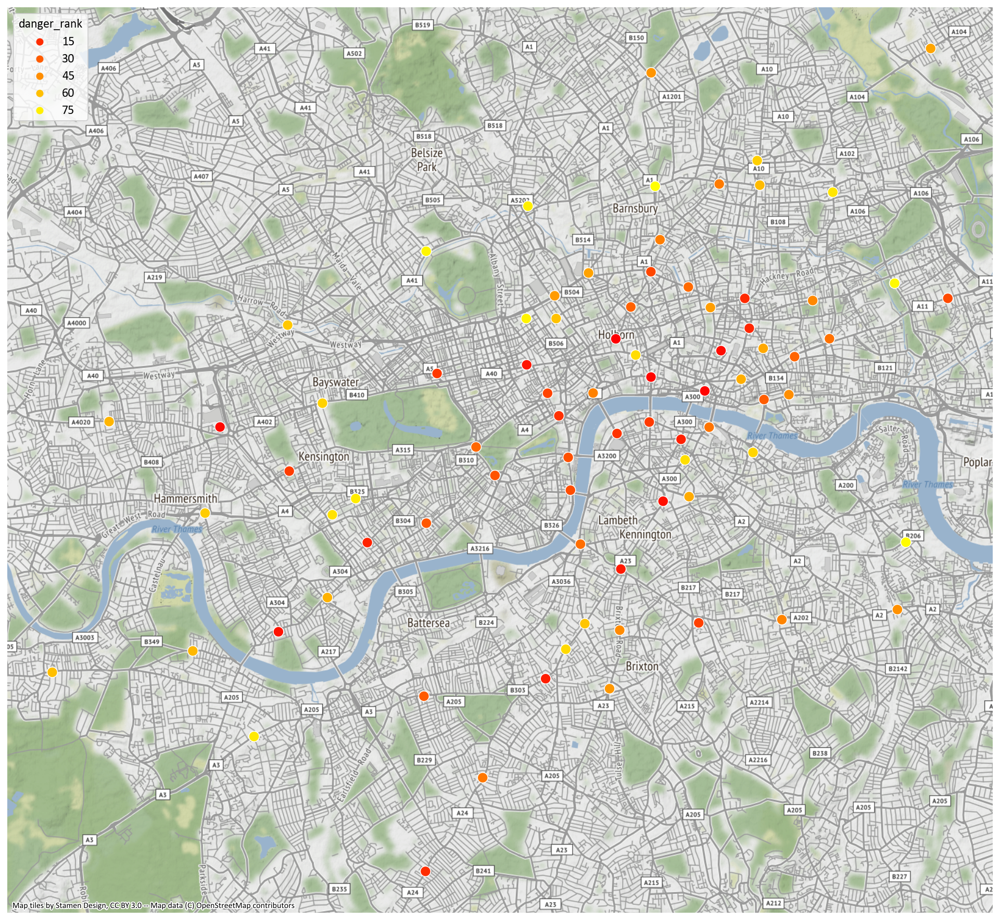

In [59]:
fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions.head(80)

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.danger_rank,
    palette='autumn',
    alpha=1,
    s=100,
    legend=True
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

# 6. Add in slight collisions

Kept these separate before to prevent messing with clustering, but now can add them.

To add them in we'll find their nearest junction and check if it's within certain threshold.

__ISSUE:__ Some junctions may 'mop' up collisions, so not sure it works to scale by n_slight...

In [60]:
tree = spatial.KDTree(junctions[['latitude', 'longitude']])

slight[['distance', 'index']] = slight.apply(
    lambda row: get_nearest_junction(row, tree), axis=1, result_type='expand'
)

slight_counts = slight[slight['distance'] < .01].groupby('index')['id'].count().reset_index(name='n_slight')

junctions_plus_slight = junctions.merge(slight_counts, how='left', on='index')

junctions_plus_slight['scaled_collision_metric'] = (
    junctions_plus_slight['collision_metric'] / junctions_plus_slight['n_slight']
)
junctions_plus_slight.sort_values(by='scaled_collision_metric', ascending=False).head(20)

,index,cluster,latitude,longitude,collision_metric,n_serious,n_fatal,danger_rank,geometry,n_slight,scaled_collision_metric
0,224,30,51.520412,-0.113629,105.316117,110,8,1.0,POINT (-12649.112 6713870.050),23,4.578962
3,556,6,51.505712,-0.219658,68.539981,70,0,4.0,POINT (-24452.264 6711240.514),43,1.593953
5,579,71,51.493327,-0.100966,46.209946,49,2,6.0,POINT (-11239.508 6709025.914),29,1.593446
6,346,41,51.471540,-0.204010,46.085361,45,0,7.0,POINT (-22710.277 6705131.401),38,1.212773
440,388,448,51.463878,-0.176450,3.434569,3,0,440.5,POINT (-19642.361 6703762.163),3,1.144856
8,568,61,51.482009,-0.112286,42.492280,45,3,9.0,POINT (-12499.593 6707002.549),38,1.118218
50,257,33,51.531397,-0.120942,15.717726,19,1,51.0,POINT (-13463.241 6715835.421),15,1.047848
67,343,407,51.468630,-0.127031,13.235839,11,0,68.0,POINT (-14140.976 6704611.374),13,1.018141
33,600,90,51.529053,-0.094205,19.692026,19,0,34.0,POINT (-10486.847 6715415.979),20,0.984601
122,453,506,51.485661,-0.145598,8.475130,7,0,123.0,POINT (-16207.848 6707655.379),9,0.941681


## Plot most dangerour 'scaled' junctions

Scaling too agressive currently.

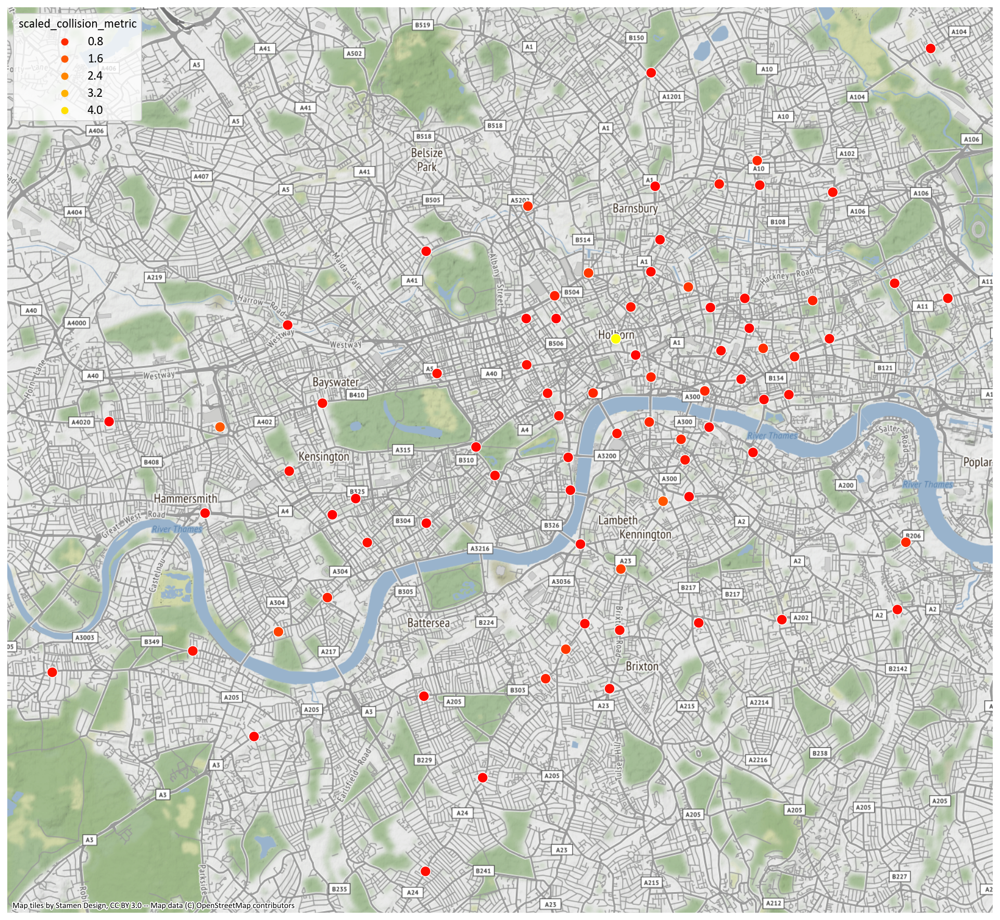

In [61]:
gpd_junctions_plus_slight = geopandas.GeoDataFrame(
    junctions_plus_slight,
    geometry=geopandas.points_from_xy(junctions_plus_slight.longitude, junctions_plus_slight.latitude, crs="EPSG:4326")
)
gpd_junctions_plus_slight.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions_plus_slight.head(80)

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.scaled_collision_metric,
    palette='autumn',
    alpha=1,
    s=100,
    legend=True
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

# 7. Plot above junctions (from 5.) with leaflet

Interactivity for zooming in & out.

In [62]:
m = Map(
    center=(51.486622, -0.170814),
    zoom=11,
    # basemap=basemaps.Strava.Ride
    basemap=basemaps.CartoDB.Positron
)

clusters_to_plot = junctions.sort_values(by='danger_rank').head(80).cluster

for lon, lat in junctions[junctions['cluster'].isin(clusters_to_plot)][["longitude", "latitude"]].values:
    marker = Marker(location=(lat, lon), draggable=False, name='hi')
    m.add_layer(marker)
    
m.layout.height="600px"

m

Map(center=[51.486622, -0.170814], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…